# Downsampling Images with Principal Component Analysis

In [2]:
import os
from PIL import Image, ImageDraw, ImageFont
import numpy as np
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

Principal Component Analysis (PCA) is a linear transformation technique commonly used in machine learning and data analysis. It identifies orthogonal directions (principal components) in the data that capture the greatest variance. These components are ranked by the amount of variance they explain, allowing us to approximate the original data using fewer features while preserving as much informational content as possible.

We can apply this technique within computer vision to downsample images, thereby saving space and maximizing an info:space ratio.

In a separate script, I will apply this to a corpus of pictures I took on vacation of text labels to save space on my phone whilst retaining the most valuable information.

Below is a graphical representation of the amount of variance captured in the red channel of an singular image alone, using up to the 50th principal component.

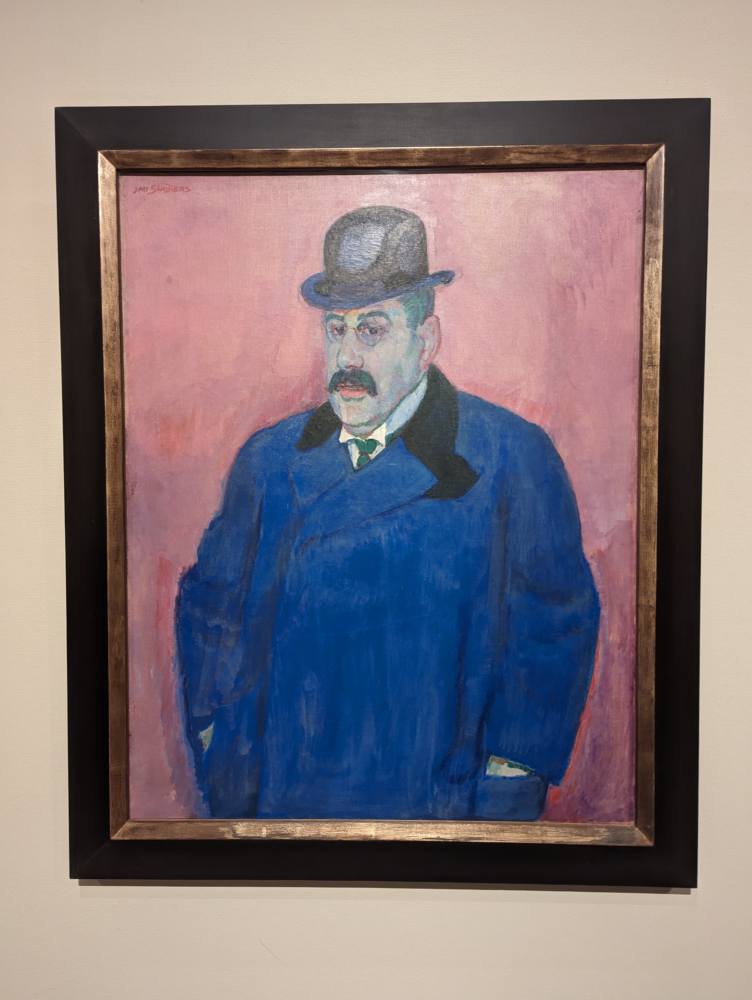

In [3]:
# location of the test image of an artwork, an oil portrait of Salomon Beffie by Jan Sluijters
img = Image.open('./testing_pictures/art.jpg')

#so you can see the image we're working with
img



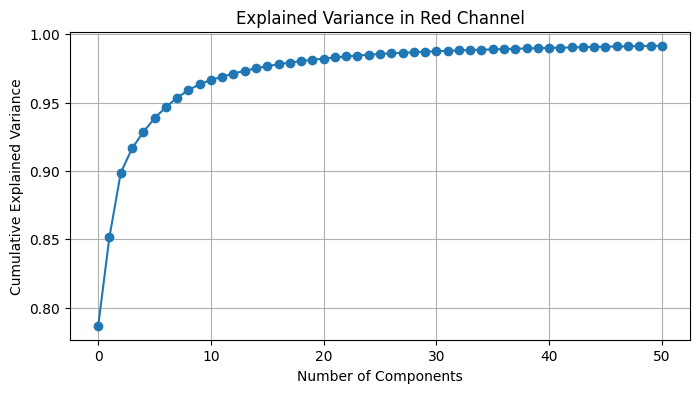

In [32]:
# We transform the image into an array with dimensions (pixel height, pixel width, 3 channels for RBG values)
img_array = np.array(img)

# directionally, only working with the red channel to demonstrate the component:variance tradeoff
red_channel = img_array[:, : , 0]

# Apply PCA
pca = PCA()
pca.fit(red_channel)

# Get explained variance ratio for the first 50 components
explained = pca.explained_variance_ratio_[0:51]

# Plot this information
plt.figure(figsize=(8, 4))
plt.plot(np.cumsum(explained), marker='o')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.title('Explained Variance in Red Channel')
plt.grid(True)
plt.show()


While I'm not interested to downsample any of the pictures of artworks themselves, I do it here to better showcase the info:space ratio and how that differs across the number of components used for an artwork vs. being used for a text label.

In [ ]:
# List of components to iterate over
num_component_list = [1, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50]

# in case image data insn't already a float
img_array = img_array.astype(np.float32)

for i in num_component_list:
    pca_transformed_channels = []

    # because we're working in color, we apply PCA to each color channel
    for ch in range(3):
        channel = img_array[:, :, ch]

        pca = PCA(n_components=i)
        transformed = pca.fit_transform(channel)
        reconstructed = pca.inverse_transform(transformed)

        pca_transformed_channels.append(reconstructed)

    # stack them back together to reconstruct the image
    reconstructed_img = np.stack(pca_transformed_channels, axis=2)
    reconstructed_img = np.clip(reconstructed_img, 0, 255).astype(np.uint8)

    # Convert to image for drawing
    img_with_caption = Image.fromarray(reconstructed_img)
    draw = ImageDraw.Draw(img_with_caption)

    # load font, create caption
    font = ImageFont.truetype("arial.ttf", size=120)
    caption = f"{i} components"

    # caption positioning
    margin = 20
    x = margin + 50
    y = img_with_caption.height - 300

    text_bbox = draw.textbbox((x, y), caption, font=font)
    text_width = text_bbox[2] - text_bbox[0]
    text_height = text_bbox[3] - text_bbox[1]
    padding = 20

    # caption background
    draw.rectangle([x, y, min(x + text_width + padding, img_with_caption.width),
                    min(y + text_height + padding, img_with_caption.height)], fill=(0, 0, 0, 128))

    # draw the text
    draw.text((x + padding // 5, y + padding // 5), caption, fill="black", font=font)
    draw.text((x, y), caption, fill="white", font=font)

    # Save final image
    out_path = f"./testing_pictures/art_pca_{i}_components.jpg"
    img_with_caption.save(out_path, format='JPEG', quality=85)


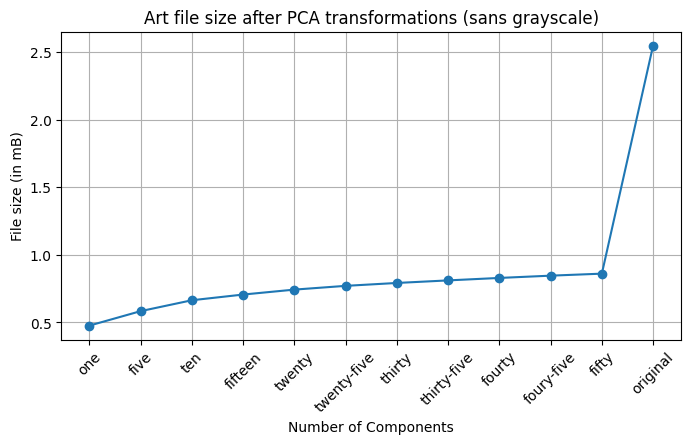

In [ ]:
# codeblock to graphically show the file sizes
art_check_files = []
for i in os.listdir('./testing_pictures'):
    
    if i.__contains__('art') & i.__contains__('jpg'):
        art_check_files.append(tuple([i, os.path.getsize('./testing_pictures/'+i)/1000000 ]))

    else: 
        next

#sorting by their file size
art_check_files.sort(key = lambda x: x[1])


# Plot this information
plt.figure(figsize=(8, 4))
plt.plot([x[1] for x in art_check_files], marker='o')
plt.xlabel('Number of Components')
plt.ylabel('File size (in mB)')
plt.title('Art file size after PCA transformations (sans grayscale)')
plt.xticks(ticks=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11], 
           labels=['one', 'five', 'ten', 'fifteen', 'twenty','twenty-five', 'thirty', 'thirty-five','fourty','foury-five', 'fifty','original'],
           rotation=45)
plt.grid(True)
plt.savefig('testing_pictures/art_savings_fig.png', bbox_inches = 'tight')
plt.show()

    

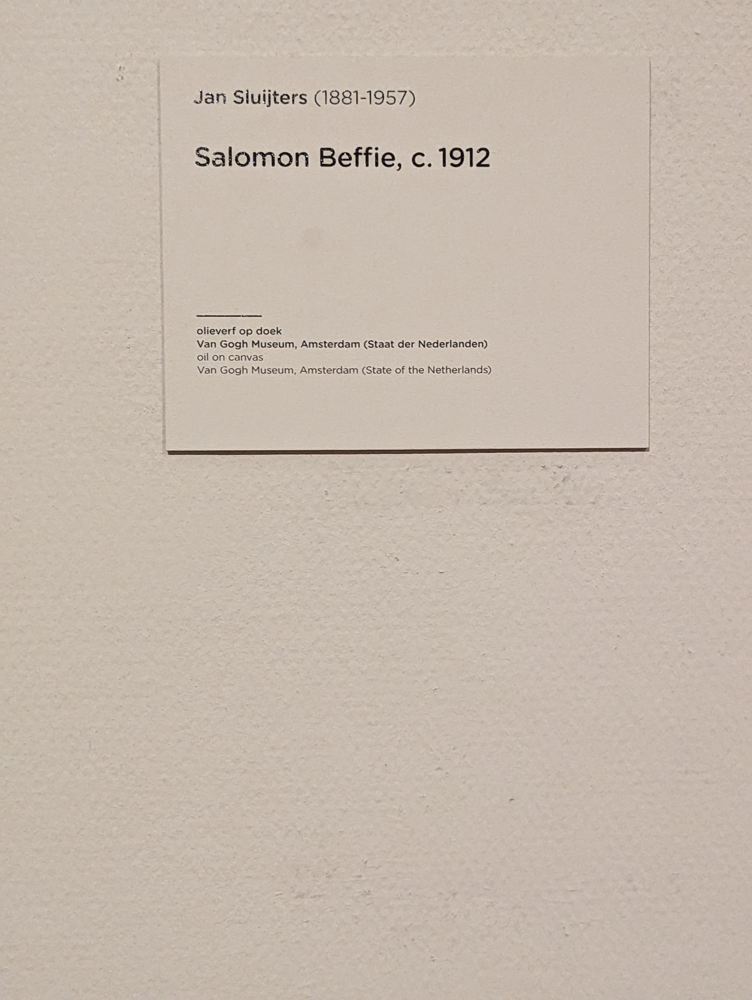

In [7]:
# same steps as above, but now for text label pic of the example artwork, which we convert to grayscale for ultimate file size savings
img = Image.open('./testing_pictures/label.jpg')
img


In [ ]:
img = img.convert('L')
img_array = np.array(img).astype(np.float32)

for i in num_component_list:
    # PCA downsampling
    pca = PCA(n_components=i)
    transformed = pca.fit_transform(img_array)
    reconstructed = pca.inverse_transform(transformed)
    reconstructed_img = np.clip(reconstructed, 0, 255).astype(np.uint8)

    # Convert to RGB draw caption labeling amount of components
    img_with_caption = Image.fromarray(reconstructed_img.astype(np.uint8)).convert('RGB')
    draw = ImageDraw.Draw(img_with_caption)

    font = ImageFont.truetype("arial.ttf", size=120)  
    
    caption = f"{i} components"

    
    margin = 20
    x = margin+50
    y = img_with_caption.height - 300  

    # background for text caption
    text_bbox = draw.textbbox((x, y), caption, font=font)
    text_width = text_bbox[2] - text_bbox[0]
    text_height = text_bbox[3] - text_bbox[1]
    padding = 20  

    draw.rectangle([x, y, min(x + text_width + padding, img_with_caption.width), 
                    min(y + text_height + padding, img_with_caption.height)], fill=(0, 0, 0, 128))

    draw.text((x + padding // 5, y + padding // 5), caption, fill="black", font=font)
    draw.text((x, y), caption, fill="white", font=font)

    # Save the image
    out_path = f"./testing_pictures/label_pca_{i}_components.jpg"
    img_with_caption.convert('L').save(out_path, format='JPEG', quality=85)


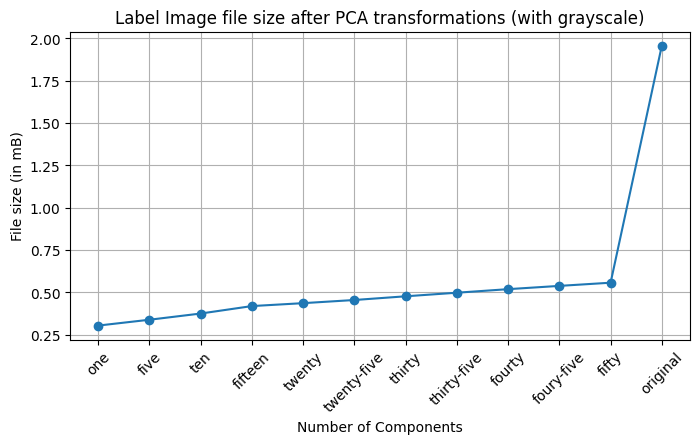

In [ ]:
label_check_files = []
for i in os.listdir('./testing_pictures'):
    if i.__contains__('label') & i.__contains__('.jpg'):
        label_check_files.append(tuple([i, os.path.getsize('./testing_pictures/'+i)/1000000 ]))
    else:
        next

label_check_files.sort(key = lambda x: x[1])

[x[1] for x in label_check_files]


# Plot this information
plt.figure(figsize=(8, 4))
plt.plot([x[1] for x in label_check_files], marker='o')
plt.xlabel('Number of Components')
plt.ylabel('File size (in mB)')
plt.title('Label Image file size after PCA transformations (with grayscale)')
plt.xticks(ticks=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11], 
           labels=['one', 'five', 'ten', 'fifteen', 'twenty','twenty-five', 'thirty', 'thirty-five','fourty','foury-five', 'fifty','original'],
           rotation=45)
plt.grid(True)
plt.savefig('testing_pictures/label_savings_fig.png', bbox_inches = 'tight')
plt.show()

    

In [ ]:
# creating a .gif of the art files
filenames = [x for x in [os.getcwd()+'/testing_pictures/'+x[0] for x in art_check_files]]
import imageio
images = []
for filename in filenames:
    images.append(imageio.imread(filename))
imageio.mimsave('./testing_pictures/art.gif', images, loop = 0, duration = 400)

#and then the label files

filenames = [os.path.join(os.getcwd(), 'testing_pictures', x[0]) for x in label_check_files]
images = []

for filename in filenames:
    img = Image.open(filename)

    # Convert grayscale to RGB for consistent shape (required for imageio GIFs)
    if img.mode != 'RGB':
        img = img.convert('RGB')

    images.append(np.array(img))

# Save the GIF
imageio.mimsave('./testing_pictures/label.gif', images, loop=0, duration=400)


C:\Users\Nick\AppData\Local\Temp\ipykernel_22896\895677246.py:6: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  images.append(imageio.imread(filename))
